In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
%config InlineBackend.figure_format = 'retina'

In [4]:
import sys
sys.path.append('../src')

In [5]:
import matplotlib.pyplot as plt
import scanpy as sc
import seaborn as sns
import pandas as pd
from spaceoracle.models.parallel_estimators import SpatialCellularProgramsEstimator
from spaceoracle.oracles import SpaceTravLR


In [6]:
adata_train = sc.read_h5ad('.cache/10X_tonsil_processed.h5ad')
# adata_train = sc.read_h5ad('/Users/koush/Projects/SpaceOracle/notebooks/.cache/adata_train.h5ad')
adata_train

AnnData object with n_obs × n_vars = 4194 × 5014
    obs: 'celltype'
    uns: 'hvg', 'log1p', 'spatial'
    obsm: 'spatial'
    layers: 'counts', 'imputed_count', 'normalized_count', 'raw_count'

In [7]:
factors2regions = {
    0: 'Plasma Cells',
    1: 'Cycling B Cells',
    2: 'Follicular Dendritic Cells ',
    3: 'Dark Zone B Cells',
    4: 'IFN B Cells',
    5: 'T Cells',
    6: 'Light Zone B Cells',
    7: 'Memory B Cells',
    8: 'Naive B Cells',
    9: 'GC-Tfh'
}

In [8]:
# Convert celltype values using the reverse mapping
factors2regions_rev = {v: k for k, v in factors2regions.items()}
adata_train.obs['cluster'] = adata_train.obs['celltype'].map(factors2regions_rev)
adata_train.obs

,celltype,cluster
AACACGTGCATCGCAC-1,Naive B Cells,8
AACACTTGGCAAGGAA-1,Light Zone B Cells,6
AACAGGAAGAGCATAG-1,Cycling B Cells,1
AACAGGATTCATAGTT-1,Follicular Dendritic Cells,2
AACAGGCCAACGATTA-1,Follicular Dendritic Cells,2
...,...,...
TGTTGGAACCTTCCGC-1,T Cells,5
TGTTGGAACGAGGTCA-1,T Cells,5
TGTTGGAAGCTCGGTA-1,T Cells,5
TGTTGGATGGACTTCT-1,Follicular Dendritic Cells,2


In [9]:
'PAX5' in adata_train.var_names

True

In [10]:
estimator = SpatialCellularProgramsEstimator(
    adata=adata_train,
    target_gene='PAX5',
    layer='imputed_count',
    cluster_annot='cluster',
    grn_type='human_tonsil',
    species='human'
)

In [11]:
%%time

estimator.fit(num_epochs=100, threshold_lambda=1e-3, learning_rate=5e-4)

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


KeyboardInterrupt: 

In [55]:
estimator.betadata.to_parquet(f'./models/{estimator.target_gene}_betadata.parquet')

In [12]:
so = SpaceTravLR(adata=adata_train, save_dir = './models')
# so = SpaceTravLR(adata=adata_train, save_dir = '/Users/koush/Downloads/models_v2')
gene_mtx = so.adata.layers[estimator.layer]
beta_dict = {estimator.target_gene: so._get_betas(estimator.target_gene)}

gex_df = estimator.adata.to_df(layer=estimator.layer)
beta_dict = so._get_wbetas_dict(beta_dict, gex_df)
wbetas = beta_dict[estimator.target_gene].wbetas[1]

xy = pd.DataFrame(
    adata_train.obsm['spatial'], index=adata_train.obs.index, columns=['x', 'y'])

df = wbetas \
        .join(adata_train.obs) \
        .join(xy) \
        .join(gex_df)

# df = df.join(beta_dict[estimator.target_gene].betas)

In [13]:
estimator.adata.obs['celltype'].value_counts().to_frame().reset_index()['celltype'].apply(
    lambda x: factors2regions_rev[x]
)

0    5
1    8
2    7
3    2
4    0
5    9
6    6
7    1
8    3
9    4
Name: celltype, dtype: category
Categories (10, int64): [1, 3, 2, 9, ..., 7, 8, 0, 5]

In [14]:
markers = ['v', 'o', 'X', '<', '^', 'v', 'D', '>', 's', 'p']
markers = ['o'] * 10

cmaps = dict(zip(range(10), ['rainbow', 'cool', 'RdYlGn_r', 'spring_r', 'Greys', 'PuRd', 'Reds', 'seismic', 'PuBuGn', 'coolwarm']))
# cell_map = dict(zip(df['rctd_cluster'], df['rctd_celltypes']))
cell_map = factors2regions
colors = ['red', 'blue', 'green', 'purple', 'orange', 'brown', 'pink', 'gray', 'cyan', 'magenta']


def plot(plot_for, clusters=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9], with_expr=False, size=25, linewidth=0.5, alpha=1, edgecolor='black', dpi=100, figsize=(11, 9), fig=None, axes=None):

    if fig is None or axes is None:
        fig, (ax, cax) = plt.subplots(1, 2, dpi=dpi, figsize=figsize, gridspec_kw={'width_ratios': [4, 0.5]})
    else:
        ax, cax = axes

    # Get cluster-specific min/max for individual colorbar scales
    norms = {}
    for j, i in enumerate(clusters):
        cluster_data = df[df.cluster==i][plot_for]
        vmin = cluster_data.min()
        vmax = cluster_data.max()
        norms[j] = plt.Normalize(vmin=vmin, vmax=vmax)

    for j, i in enumerate(clusters):
        betas_df = df[df.cluster==i]
        missing_columns = list(set(estimator.train_df.columns) - set(betas_df.columns))
        betas_df = betas_df.join(estimator.train_df[missing_columns])

        if with_expr:
            betas_df[plot_for] = betas_df[plot_for]*betas_df[plot_for.replace('beta_', '')]

        cluster_color = colors[j] 

        sns.scatterplot(
            data=betas_df,
            x='x', 
            y='y',
            hue=plot_for,
            palette=cmaps[j],
            s=size,
            alpha=alpha,
            linewidth=linewidth,
            edgecolor=cluster_color,
            legend=False,
            style='celltype',
            markers=markers,
            ax=ax
        )
    ax.axis('off')

    cbar_width = 0.15  # Width of each colorbar
    cbar_height = 0.425 / len(cmaps)  # Height of each colorbar
    for i, cmap_name in cmaps.items():
        # if i not in [0, 1, 2]:
        #     continue
        cmap = plt.get_cmap(cmap_name)
        sm = plt.cm.ScalarMappable(cmap=cmap, norm=norms[i])
        sm.set_array([])
        cax_i = cax.inset_axes([0.2, 0.95 - (i+1)*cbar_height*2.5, cbar_width, cbar_height*1.5])
        cbar = fig.colorbar(sm, cax=cax_i, orientation='vertical')
        cbar.ax.tick_params(labelsize=9)  # Reduce tick label size
        cbar.ax.set_title(f'{cell_map[i]}', fontsize=12, pad=8)  # Reduce title size and padding

    cax.set_ylabel(plot_for, fontsize=8)
    cax.axis('off')

    unique_styles = sorted(set(df['celltype']))
    style_handles = [plt.Line2D([0], [0], marker=m, color='w', markerfacecolor='gray', 
                    markersize=10, linestyle='None', alpha=1) 
                    for m in markers][:len(unique_styles)]
    ax.legend(style_handles, unique_styles, ncol=4,
        title='Cell types', loc='lower left', bbox_to_anchor=(0, -0.125),
        frameon=False)

    ax.set_title(f'{plot_for} > {estimator.target_gene}', fontsize=15)
    
    return ax

In [19]:
import anndata as ad

In [20]:
adata_beta = ad.AnnData(df[[i for i in df.columns if 'beta_' in i]], obs=estimator.adata.obs, obsm=estimator.adata.obsm, uns=estimator.adata.uns)

In [416]:
[i for i in adata_beta.var_names if 'beta_IL2' in i]

['beta_IL2',
 'beta_IL20',
 'beta_IL20RA',
 'beta_IL20RB',
 'beta_IL21',
 'beta_IL21R',
 'beta_IL22',
 'beta_IL22RA1',
 'beta_IL23A',
 'beta_IL23R',
 'beta_IL24',
 'beta_IL25',
 'beta_IL26',
 'beta_IL27',
 'beta_IL27RA',
 'beta_IL2RB',
 'beta_IL2RG']

In [16]:
import squidpy as sq

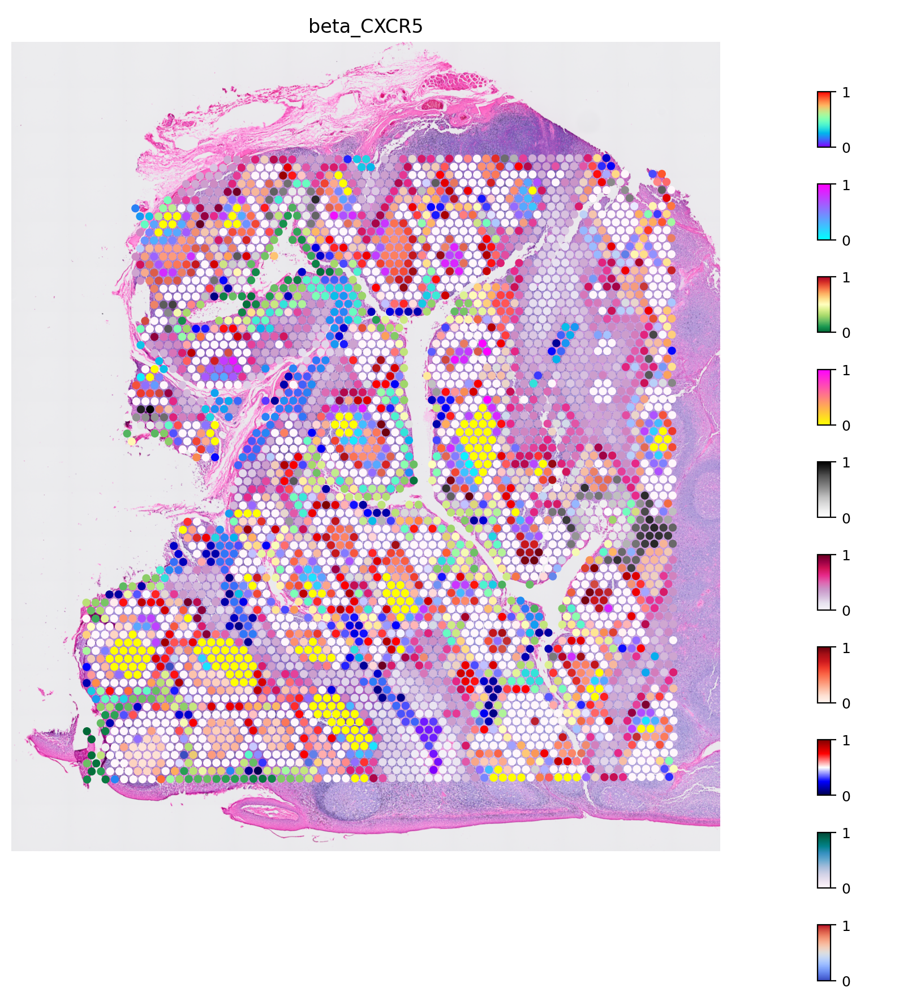

In [25]:
cmaps = dict(zip(range(10), ['rainbow', 'cool', 'RdYlGn_r', 'spring_r', 'Greys', 'PuRd', 'Reds', 'seismic', 'PuBuGn', 'coolwarm']))
fig, (ax, cax) = plt.subplots(1, 2, dpi=100, figsize=(10, 10), gridspec_kw={'width_ratios': [4, 0.5]})

for c in range(10):
    ax = sq.pl.spatial_scatter(adata_beta[adata_beta.obs['cluster']==c], 
            color='beta_CXCR5', size=1.25, cmap=cmaps[c], return_ax=True, 
            ax=ax, crop_coord=tuple([0, 0, 28000, 40000]), colorbar=False,
            frameon=False
        )
    
# ax2 = sq.pl.spatial_scatter(adata_beta, 
#             color='celltype', size=1.25, return_ax=True, 
#             ax=ax2, crop_coord=tuple([0, 0, 28000, 40000]), colorbar=False,
#         )

cbar_width = 0.15  # Width of each colorbar
cbar_height = 0.425 / len(cmaps)  # Height of each colorbar
for i, cmap_name in cmaps.items():
    # if i not in [0, 1, 2]:
    #     continue
    cmap = plt.get_cmap(cmap_name)
    # sm = plt.cm.ScalarMappable(cmap=cmap, norm=norms[i])
    sm = plt.cm.ScalarMappable(cmap=cmap)
    sm.set_array([])
    cax_i = cax.inset_axes([0.2, 0.95 - (i+1)*cbar_height*2.5, cbar_width, cbar_height*1.5])
    cbar = fig.colorbar(sm, cax=cax_i, orientation='vertical')
    cbar.ax.tick_params(labelsize=9)  # Reduce tick label size

cax.axis('off')

# ax.set_title('beta_BCL6 > Pax5')
plt.show()

In [341]:
# estimator.regulators

In [375]:
ax.get_xlim(), ax.get_ylim()

((1793.45, 27325.55), (3347.6, 30350.4))

In [ ]:
ax.get_ylim()

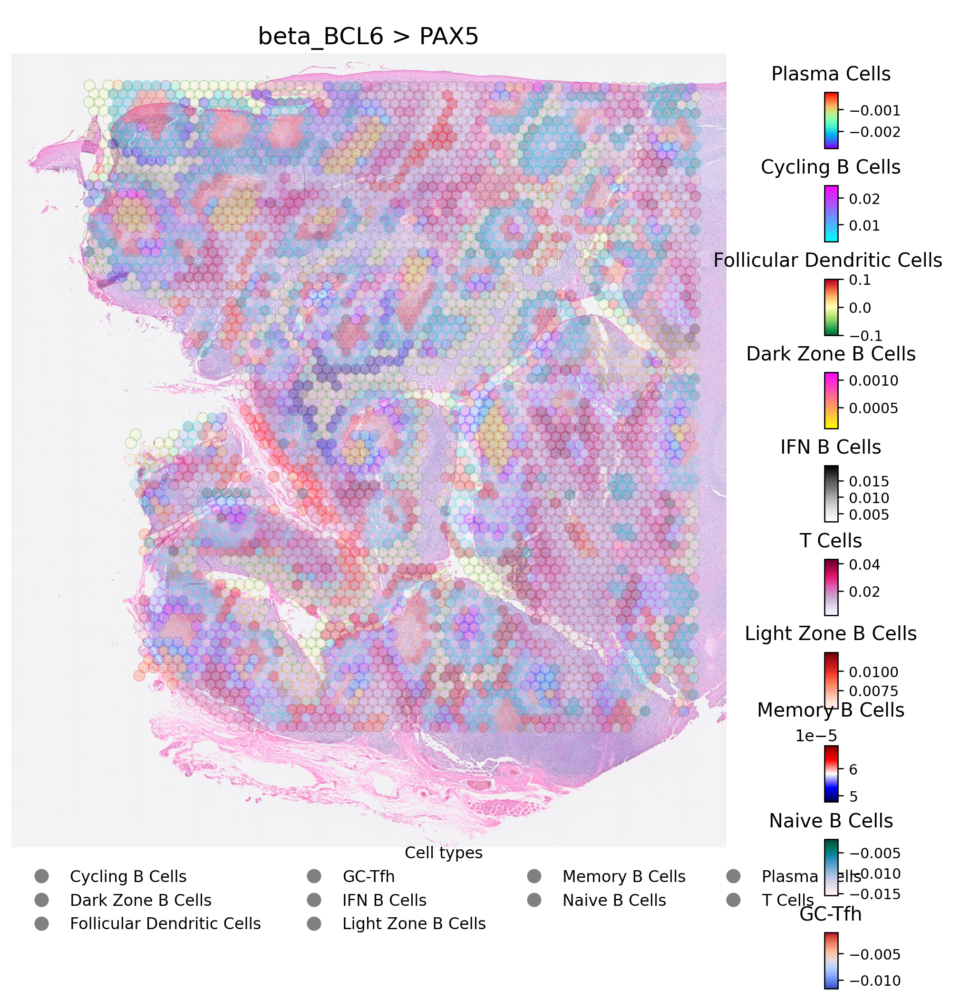

In [386]:
fig, (ax, cax) = plt.subplots(1, 2, dpi=120, figsize=(10, 10), gridspec_kw={'width_ratios': [4, 0.5]})
plot('beta_BCL6', dpi=120, size=50, with_expr=False, fig=fig, axes=(ax, cax), alpha=0.25)
img = estimator.adata.uns['spatial']['CytAssist_FFPE_Protein_Expression_Human_Tonsil']['images']['hires']
ax.imshow(np.flipud(img)[:, :1300, :], alpha=0.6, extent=(0, 27325.55) + (0, 30350.4))
plt.show()

In [134]:
import anndata as ad
import squidpy as sq

In [178]:
adata_beta = ad.AnnData(df[[i for i in df.columns if 'beta_' in i]], uns=estimator.adata.uns, obsm=estimator.adata.obsm)

In [179]:
adata_beta.var_names

Index(['beta_ACKR1', 'beta_ACKR2', 'beta_ACKR3', 'beta_ACKR4', 'beta_ADM',
       'beta_AGT', 'beta_AGTR1', 'beta_ANGPT1', 'beta_ANGPTL1', 'beta_ANGPTL2',
       ...
       'beta_WNT10B', 'beta_WNT2B', 'beta_WNT3', 'beta_WNT4', 'beta_WNT9B',
       'beta_ZBTB33', 'beta_ZBTB7A', 'beta_ZBTB7C', 'beta_ZNF423',
       'beta_ZNF467'],
      dtype='object', length=297)

In [180]:
adata_beta.to_df()['beta_ACKR1'].mean()

-0.014557516131988512

In [181]:
adata_beta

AnnData object with n_obs × n_vars = 4194 × 297
    uns: 'hvg', 'log1p', 'spatial', 'received_ligands', 'ligand_receptor', 'ligand_regulator', 'received_ligands_tfl', 'celltype_colors'
    obsm: 'spatial', 'spatial_maps', 'spatial_features'

In [182]:
import matplotlib.pyplot as plt
import numpy as np

In [183]:
adata_beta

AnnData object with n_obs × n_vars = 4194 × 297
    uns: 'hvg', 'log1p', 'spatial', 'received_ligands', 'ligand_receptor', 'ligand_regulator', 'received_ligands_tfl', 'celltype_colors'
    obsm: 'spatial', 'spatial_maps', 'spatial_features'

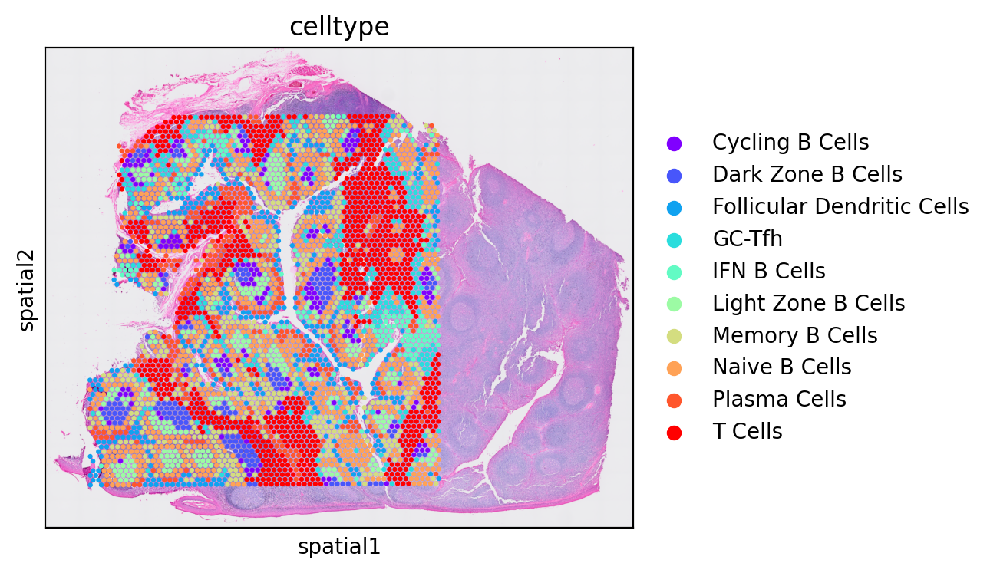

In [184]:
sq.pl.spatial_scatter(estimator.adata, color='celltype', size=1.25, palette='rainbow')

In [204]:
adata_beta.to_df().var().sort_values(ascending=False)

beta_CR2       0.021394
beta_ACKR4     0.018534
beta_CCR7      0.016215
beta_CCR6      0.016091
beta_E2F1      0.013043
                 ...   
beta_CHRND     0.000000
beta_CHRNE     0.000000
beta_NPPA      0.000000
beta_SEMA3G    0.000000
beta_PPBP      0.000000
Length: 297, dtype: float64

In [202]:
adata_beta.obs = estimator.adata.obs

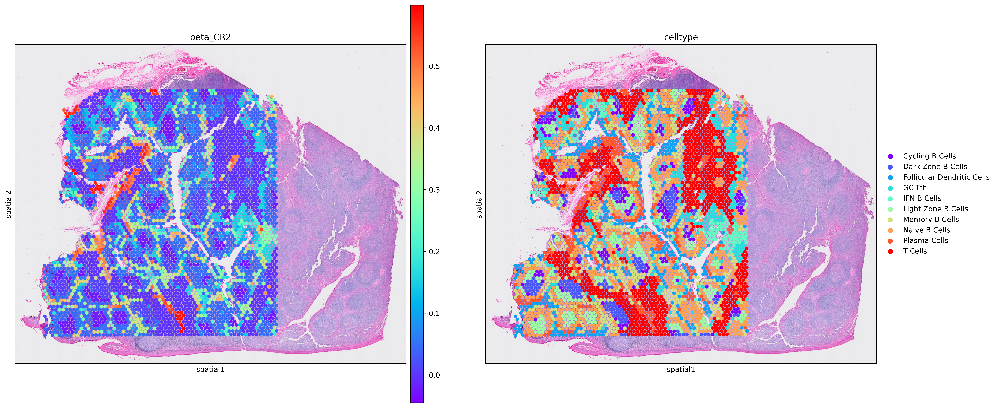

In [208]:
plt.rcParams['figure.figsize'] = (10, 10)
plt.rcParams['figure.dpi'] = 200
sq.pl.spatial_scatter(adata_beta, color=['beta_CR2', 'celltype'], 
    size=1.355, cmap='rainbow')
plt.show()

In [145]:
df.rctd_celltypes.value_counts()

rctd_celltypes
B-cell            7531
Th2               1785
Cd8 T-cell        1246
Tfh                323
Resting T-cell     274
Treg               241
NK                 167
Name: count, dtype: int64

In [148]:
from sklearn.cluster import KMeans

k = 4
kmeans = KMeans(n_clusters=k, random_state=1334).fit(df[df.rctd_celltypes=='Cd8 T-cell'][estimator.modulators_genes])
labels = kmeans.labels_

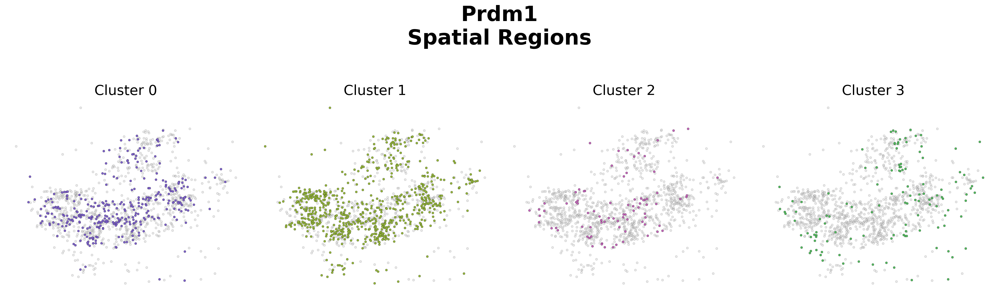

In [150]:
import matplotlib.pyplot as plt
import numpy as np

fig, axes = plt.subplots(1, 4, figsize=(20, 6))

axes = axes.ravel()

adata = estimator.adata

# Define custom colors
colors = ["#7d61ca", "#94b53b", "#c364b9", "#53ba5f", "#d14573", "#50b49b", 
          "#cb4934", "#688bcd", "#cf7d41", "#5c7c38", "#bd6a7c", "#b49544"]

for i in range(k):
    cluster_mask = labels == i

    adata_ = adata[adata.obs.rctd_celltypes=='Cd8 T-cell']
    
    axes[i].scatter(
        adata_.obsm['spatial'][:, 0], adata_.obsm['spatial'][:, 1],
        c='lightgray', s=10, edgecolors='black', linewidth=0.15, alpha=0.5
    )
    
    axes[i].scatter(
        adata_.obsm['spatial'][cluster_mask, 0], adata_.obsm['spatial'][cluster_mask, 1],
        c=colors[i], s=10, edgecolors='black', linewidth=0.15
    )
    
    axes[i].set_title(f'Cluster {i}', fontsize=20)
    axes[i].set_xticks([])  
    axes[i].set_yticks([])  

for ax in axes:
    ax.set_frame_on(False)

plt.suptitle(f'{estimator.target_gene}\nSpatial Regions\n', fontsize=30, fontweight='bold')
plt.tight_layout()
plt.show()


In [132]:
# plt.rcParams['figure.figsize'] = (45, 3)
# plt.rcParams['figure.dpi'] = 100

# hmap = df[[
#         'beta_'+i for i in estimator.modulators if '$' in i]+[
#             'rctd_celltypes']].groupby('rctd_celltypes').mean().abs()>0
# sns.heatmap(
#     hmap.loc[:, (hmap.sum(0) > 0)],
#     square=True,
#     cbar=False,
#     linewidths=0.5,
#     linecolor='black',
#     xticklabels=True,
#     yticklabels=True,
#     cmap='Reds'
# )
# plt.title(f'Modulators for {estimator.target_gene}', fontsize=15)
# plt.tight_layout()
# plt.show()
# hmap = df[[
#         'beta_'+i for i in estimator.modulators if '#' in i]+[
#             'rctd_celltypes']].groupby('rctd_celltypes').mean().abs()>0
# sns.heatmap(
#     hmap.loc[:, (hmap.sum(0) > 0)],
#     square=True,
#     cbar=False,
#     linewidths=0.5,
#     linecolor='black',
#     xticklabels=True,
#     yticklabels=True,
#     cmap='Reds'
# )

# plt.title(f'Modulators for {estimator.target_gene}', fontsize=15)
# plt.tight_layout()
# plt.show()